## Importing Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
%matplotlib inline
plt.style.use('fivethirtyeight')
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

## Loading the Dataset :

In [2]:
data = pd.read_csv('ml_project1_data_pt.csv',delimiter =',')
data.head(3)

,ID,ano_nasc,educacao,estado_civil,renda_ano,crianca_casa,adoles_casa,dt_primcomp,recencia_dias,vinho_montante,frutas_montante,carne_montante,peixe_montante,doces_montante,ouro_montante,promocoes_desconto,promocoes_web,promocoes_catalogo,promocoes_store,num_visit_web_ult_mes,Cmp3,Cmp4,Cmp5,Cmp1,Cmp2,reclamacoes,target
0,5524,1957,Graduation,Single,58138.0,0,0,9/4/2012,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,1
1,2174,1954,Graduation,Single,46344.0,1,1,3/8/2014,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,0
2,4141,1965,Graduation,Together,71613.0,0,0,8/21/2013,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,0


In [3]:
data.shape

(2240, 27)

In [4]:
data.columns

Index(['ID', 'ano_nasc', 'educacao', 'estado_civil', 'renda_ano', 'crianca_casa', 'adoles_casa', 'dt_primcomp', 'recencia_dias', 'vinho_montante', 'frutas_montante', 'carne_montante', 'peixe_montante', 'doces_montante', 'ouro_montante', 'promocoes_desconto', 'promocoes_web', 'promocoes_catalogo', 'promocoes_store', 'num_visit_web_ult_mes', 'Cmp3', 'Cmp4', 'Cmp5', 'Cmp1', 'Cmp2', 'reclamacoes', 'target'], dtype='object')

## Data Preprocessing 

In [4]:
# Checking for null values.
info = pd.DataFrame(data=data.isnull().sum()).T.rename(index={0:'Null values'})
info = info.append(pd.DataFrame(data=data.isnull().sum()/data.shape[0] * 100).T.rename(index={0:'% Null values'}))
info

,ID,ano_nasc,educacao,estado_civil,renda_ano,crianca_casa,adoles_casa,dt_primcomp,recencia_dias,vinho_montante,frutas_montante,carne_montante,peixe_montante,doces_montante,ouro_montante,promocoes_desconto,promocoes_web,promocoes_catalogo,promocoes_store,num_visit_web_ult_mes,Cmp3,Cmp4,Cmp5,Cmp1,Cmp2,reclamacoes,target
Null values,0.0,0.0,0.0,0.0,24.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
% Null values,0.0,0.0,0.0,0.0,1.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
# Checking for Duplicates :
data.duplicated().sum()

0

In [6]:
data.describe()

,ID,ano_nasc,renda_ano,crianca_casa,adoles_casa,recencia_dias,vinho_montante,frutas_montante,carne_montante,peixe_montante,doces_montante,ouro_montante,promocoes_desconto,promocoes_web,promocoes_catalogo,promocoes_store,num_visit_web_ult_mes,Cmp3,Cmp4,Cmp5,Cmp1,Cmp2,reclamacoes,target
count,2240.000000,2240.000000,2216.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000
mean,5592.159821,1968.805804,52247.251354,0.444196,0.506250,49.109375,303.935714,26.302232,166.950000,37.525446,27.062946,44.021875,2.325000,4.084821,2.662054,5.790179,5.316518,0.072768,0.074554,0.072768,0.064286,0.013393,0.009375,0.149107
std,3246.662198,11.984069,25173.076661,0.538398,0.544538,28.962453,336.597393,39.773434,225.715373,54.628979,41.280498,52.167439,1.932238,2.778714,2.923101,3.250958,2.426645,0.259813,0.262728,0.259813,0.245316,0.114976,0.096391,0.356274
min,0.000000,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2828.250000,1959.000000,35303.000000,0.000000,0.000000,24.000000,23.750000,1.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,5458.500000,1970.000000,51381.500000,0.000000,0.000000,49.000000,173.500000,8.000000,67.000000,12.000000,8.000000,24.000000,2.000000,4.000000,2.000000,5.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,8427.750000,1977.000000,68522.000000,1.000000,1.000000,74.000000,504.250000,33.000000,232.000000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,11191.000000,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,362.000000,15.000000,27.000000,28.000000,13.000000,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [7]:
data['dt_primcomp'] = pd.to_datetime(data['dt_primcomp'], errors='coerce')
data['dt_primcomp'] = data['dt_primcomp'].dt.strftime('%m/%Y')

In [8]:
data['age']= 2020 - data['ano_nasc']

In [9]:
data['renda_mes_media']= data['renda_ano']/12

In [10]:
data['campaing_engagement'] =( data['Cmp1']+data['Cmp2']+data['Cmp3']+data['Cmp4']+data['Cmp5']) /5

In [11]:
data['target'] = data['target'].astype(str)
data['Cmp1'] = data['Cmp1'].astype(str)
data['Cmp2'] = data['Cmp2'].astype(str)
data['Cmp3'] = data['Cmp3'].astype(str)
data['Cmp4'] = data['Cmp4'].astype(str)
data['Cmp5'] = data['Cmp5'].astype(str)
data['reclamacoes'] = data['reclamacoes'].astype(str)
data['digital_profile'] = '0'
data['digital_profile'][(data['num_visit_web_ult_mes']< 5) & (data['promocoes_web']<3)]='1'

## Exploratory Data Analysis :

In [13]:
data.dtypes.groupby(data.dtypes).size()

int64      17
float64     3
object     11
dtype: int64

In [15]:
dtypes = pd.DataFrame(data.dtypes.rename('type')).reset_index().astype('str')
dtypes = dtypes.query('index != "dt_primcomp"',)
dtypes = dtypes.query('index != "ID"')
dtypes = dtypes.query('index != "target"')
numeric = dtypes[(dtypes.type.isin(['int64', 'float64']))]['index'].values
categorical = dtypes[~(dtypes['index'].isin(numeric)) & (dtypes['index'] != 'target')]['index'].values

print('Numeric:\n', numeric)
print('Categorical:\n', categorical)

Numeric:
 ['ano_nasc' 'renda_ano' 'crianca_casa' 'adoles_casa' 'recencia_dias'
 'vinho_montante' 'frutas_montante' 'carne_montante' 'peixe_montante'
 'doces_montante' 'ouro_montante' 'promocoes_desconto' 'promocoes_web'
 'promocoes_catalogo' 'promocoes_store' 'num_visit_web_ult_mes' 'age'
 'renda_mes_media' 'campaing_engagement']
Categorical:
 ['educacao' 'estado_civil' 'Cmp3' 'Cmp4' 'Cmp5' 'Cmp1' 'Cmp2'
 'reclamacoes' 'digital_profile']


#### Categorical Data Analysis

In [830]:
pylab.rcParams['figure.figsize'] = (6.0, 4.0)

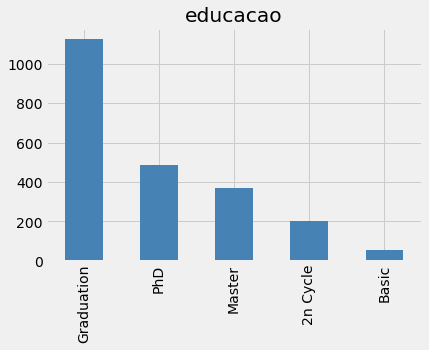

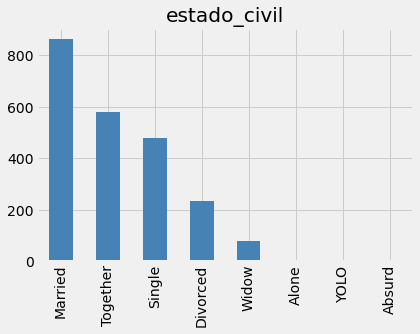

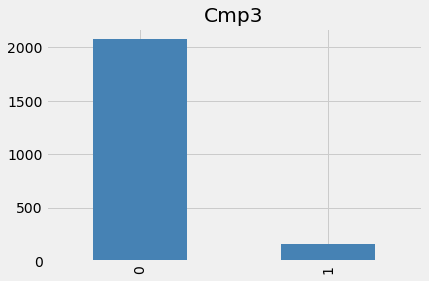

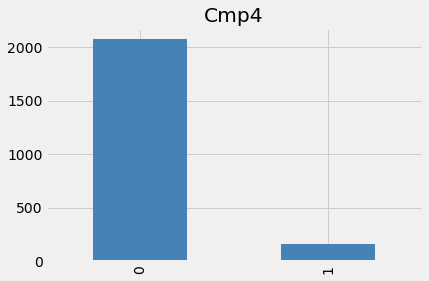

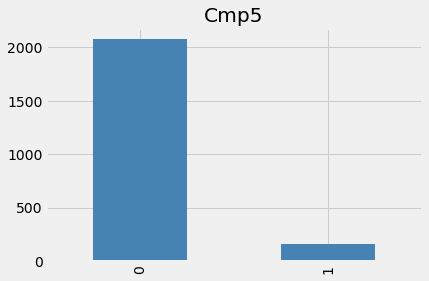

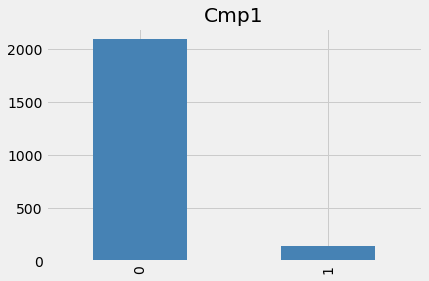

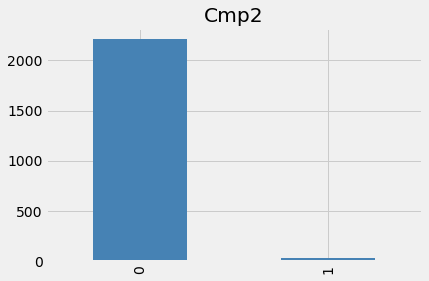

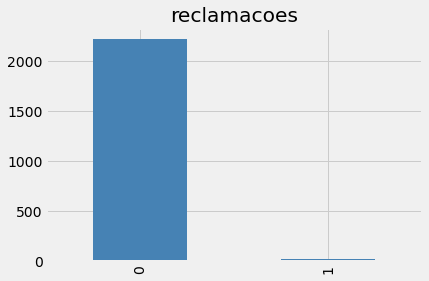

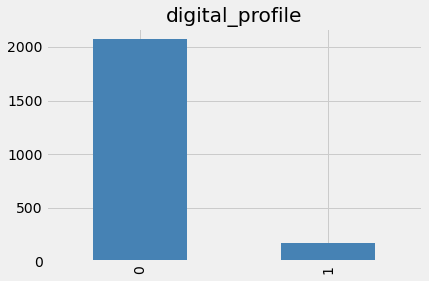

In [16]:
for attr in categorical:
  figsize=(8,4)  
  plt.figure()
  data[attr].value_counts().plot(kind='bar', color='steelblue');
  plt.title(attr);

Support (educacao)

Graduation    1127
PhD            486
Master         370
2n Cycle       203
Basic           54
Name: educacao, dtype: int64 

Support (estado_civil)

Married     864
Together    580
Single      480
Divorced    232
Widow        77
Alone         3
YOLO          2
Absurd        2
Name: estado_civil, dtype: int64 

Support (Cmp3)

0    2077
1     163
Name: Cmp3, dtype: int64 

Support (Cmp4)

0    2073
1     167
Name: Cmp4, dtype: int64 

Support (Cmp5)

0    2077
1     163
Name: Cmp5, dtype: int64 

Support (Cmp1)

0    2096
1     144
Name: Cmp1, dtype: int64 

Support (Cmp2)

0    2210
1      30
Name: Cmp2, dtype: int64 

Support (reclamacoes)

0    2219
1      21
Name: reclamacoes, dtype: int64 

Support (digital_profile)

0    2071
1     169
Name: digital_profile, dtype: int64 



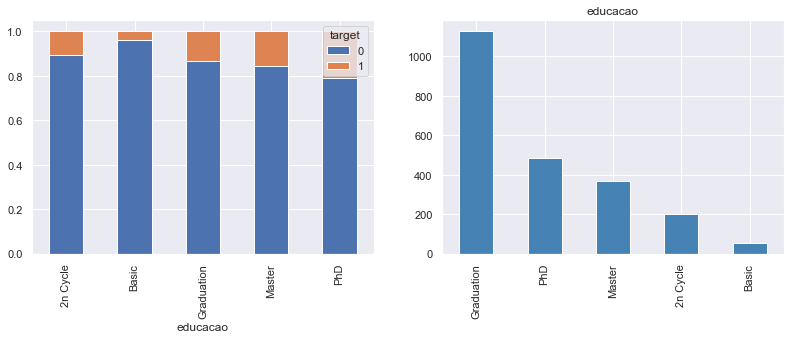

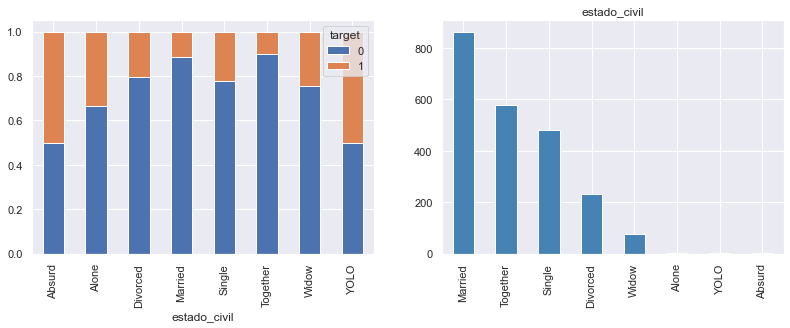

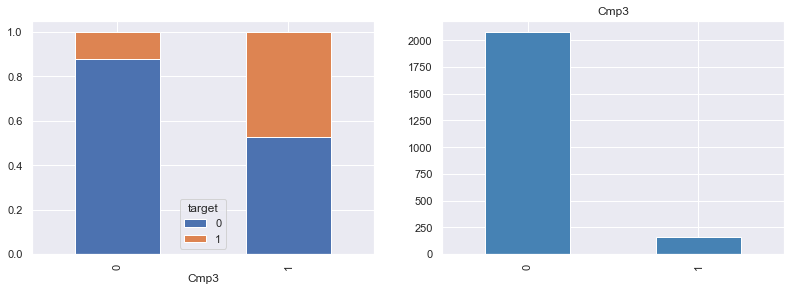

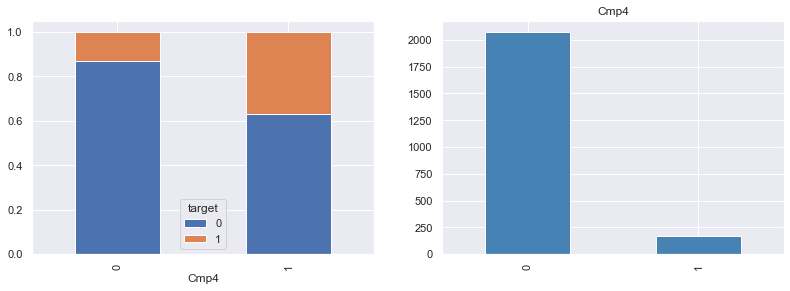

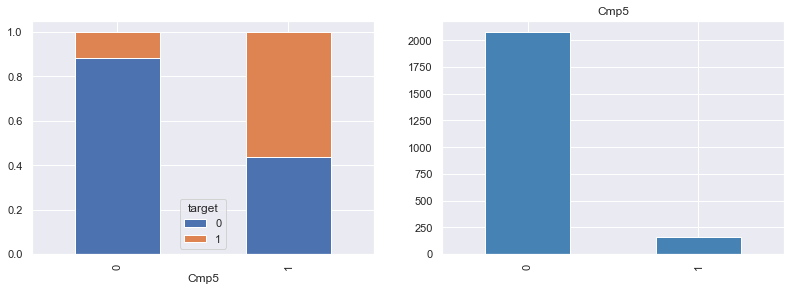

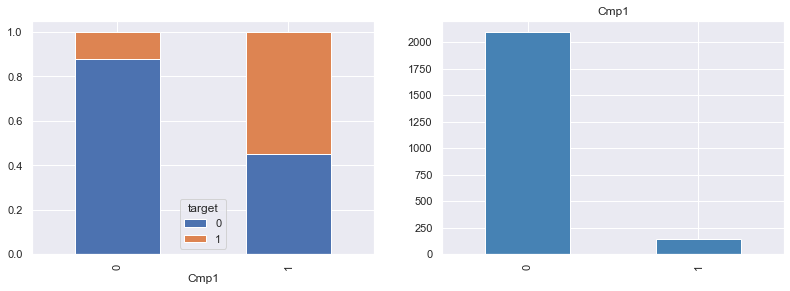

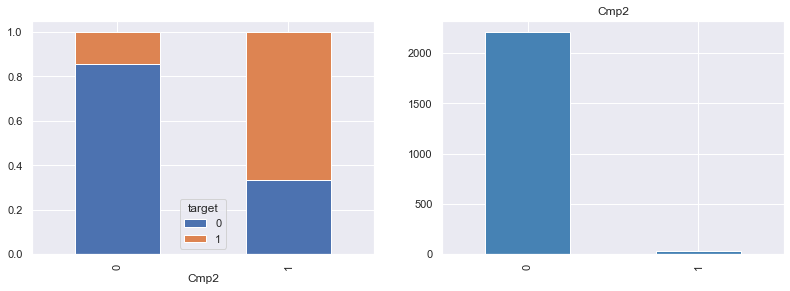

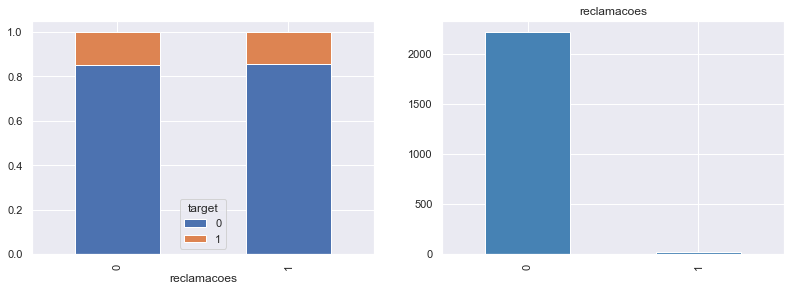

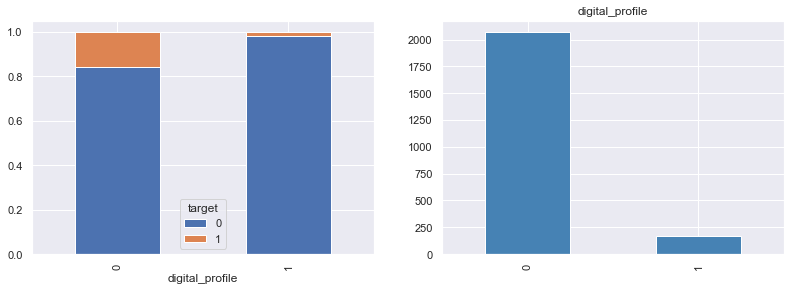

In [56]:
for attr in categorical:
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,4))
  outcome_counts = data.groupby([attr, 'target']).size().rename('count').reset_index()
  by_outcome = outcome_counts.pivot(columns='target', values='count', index=attr)
  # Plot the proportions
  by_outcome.div(by_outcome.sum(1), axis=0).plot.bar(stacked=True, ax=ax1);
  # Plot the counts
  data[attr].value_counts().plot.bar(ax=ax2, legend=False,color='steelblue');
  print('Support (%s)\n' % attr)
  print(data[attr].value_counts(), '\n')
  plt.title(attr);

#### Date Analysis

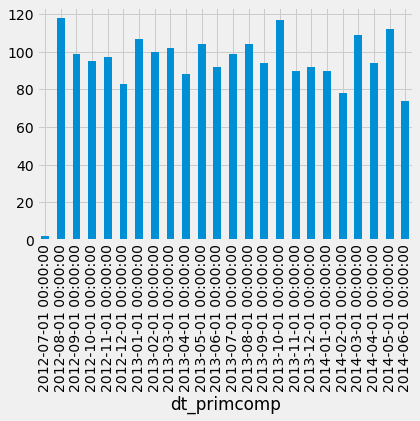

In [18]:
data['dt_primcomp'] = pd.to_datetime(data['dt_primcomp'], infer_datetime_format=True)
data.groupby('dt_primcomp')['ID'].nunique().plot(kind='bar')
plt.show()

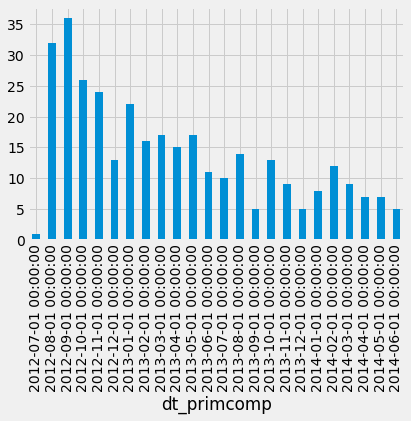

In [21]:
data['target'] = data['target'].astype(int)
data.groupby('dt_primcomp')['target'].sum().plot(kind='bar')
plt.show()

C:\Users\patri\anaconda3\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  This is separate from the ipykernel package so we can avoid doing imports until


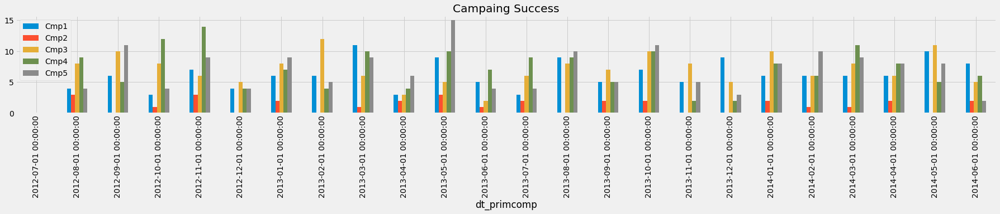

<Figure size 1440x1296 with 0 Axes>

In [280]:
# campaing
pylab.rcParams['figure.figsize'] = (28, 3)
data.groupby(('dt_primcomp'))['Cmp1','Cmp2','Cmp3','Cmp4','Cmp5'].sum().plot(kind='bar')
plt.title("Campaing Success")
plt.figure( figsize=(20, 18))
plt.show()

#### Numerical Data Analysis

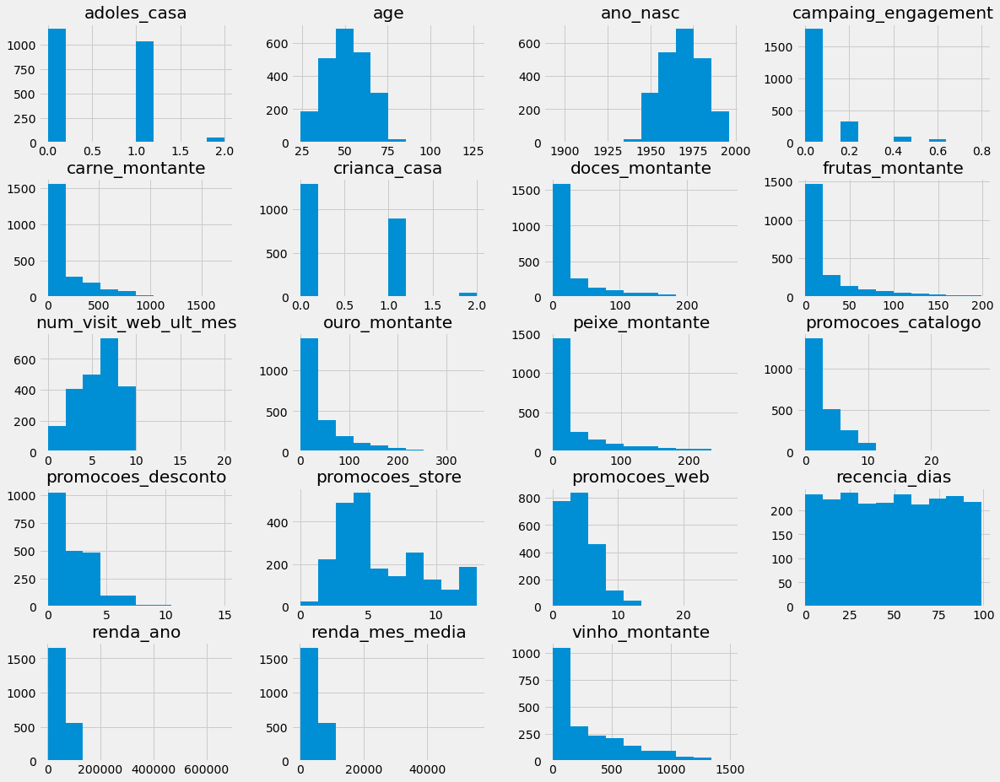

In [22]:
data[numeric].hist(figsize=(18,15));

In [23]:
data[numeric].describe()

,ano_nasc,renda_ano,crianca_casa,adoles_casa,recencia_dias,vinho_montante,frutas_montante,carne_montante,peixe_montante,doces_montante,ouro_montante,promocoes_desconto,promocoes_web,promocoes_catalogo,promocoes_store,num_visit_web_ult_mes,age,renda_mes_media,campaing_engagement
count,2240.000000,2216.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2216.000000,2240.000000
mean,1968.805804,52247.251354,0.444196,0.506250,49.109375,303.935714,26.302232,166.950000,37.525446,27.062946,44.021875,2.325000,4.084821,2.662054,5.790179,5.316518,51.194196,4353.937613,0.059554
std,11.984069,25173.076661,0.538398,0.544538,28.962453,336.597393,39.773434,225.715373,54.628979,41.280498,52.167439,1.932238,2.778714,2.923101,3.250958,2.426645,11.984069,2097.756388,0.135676
min,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,24.000000,144.166667,0.000000
25%,1959.000000,35303.000000,0.000000,0.000000,24.000000,23.750000,1.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,43.000000,2941.916667,0.000000
50%,1970.000000,51381.500000,0.000000,0.000000,49.000000,173.500000,8.000000,67.000000,12.000000,8.000000,24.000000,2.000000,4.000000,2.000000,5.000000,6.000000,50.000000,4281.791667,0.000000
75%,1977.000000,68522.000000,1.000000,1.000000,74.000000,504.250000,33.000000,232.000000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,61.000000,5710.166667,0.000000
max,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,362.000000,15.000000,27.000000,28.000000,13.000000,20.000000,127.000000,55555.500000,0.800000


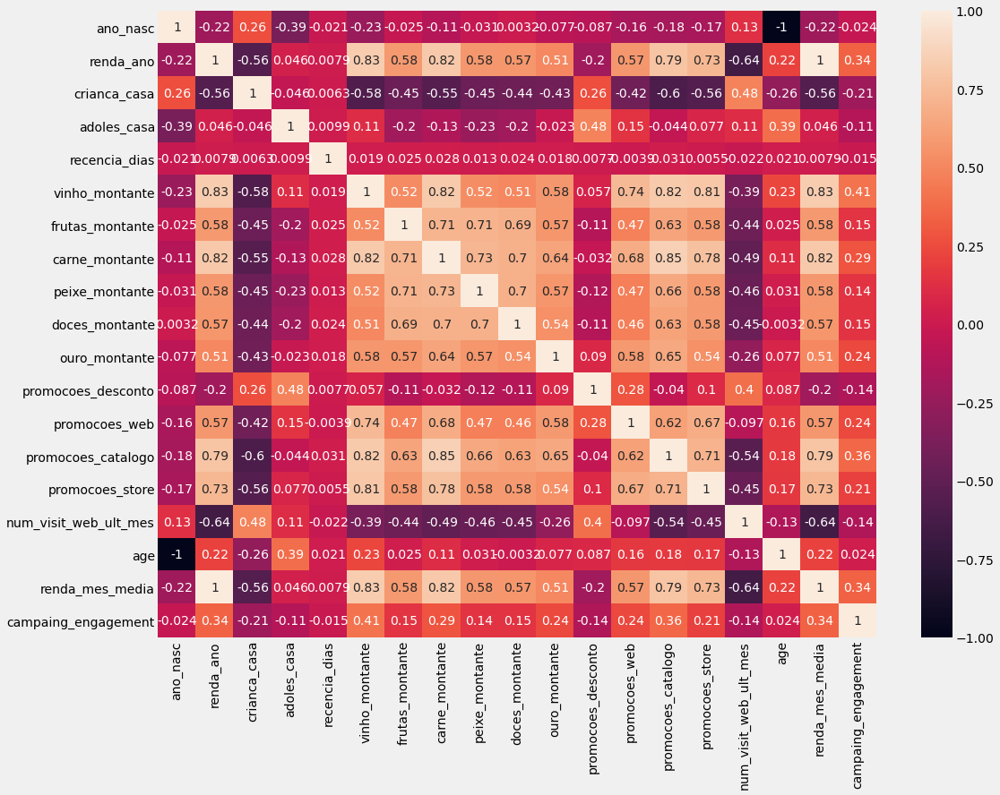

In [24]:
plt.figure(figsize=(16,12));
sns.heatmap(data[numeric].corr('spearman'), annot=True);

#### Customer Attributes

In [37]:
cust_attrs = ['age', 'renda_mes_media', 'num_visit_web_ult_mes','target']

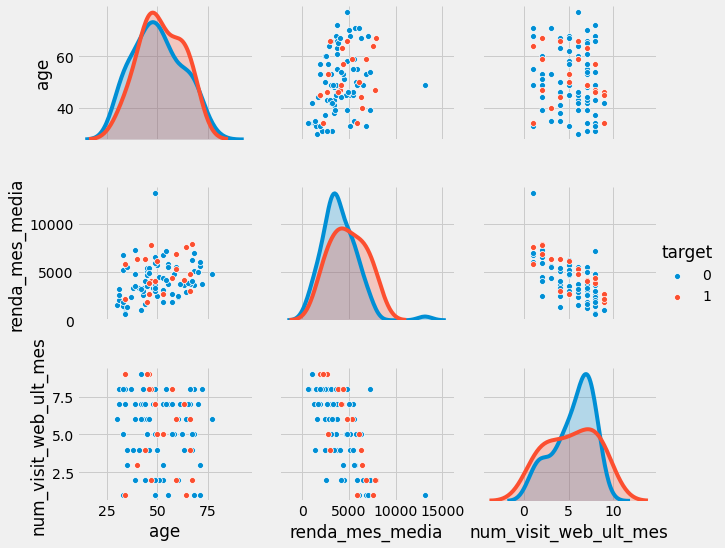

In [38]:
data['target'] = data['target'].astype(str)
numeric_outcome = pd.concat([data[numeric], data['target']], axis=1)
sns.pairplot(numeric_outcome[cust_attrs].sample(n=100), hue='target', aspect=1.2);

### Clustering

1 . Kmeans

In [14]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

In [16]:
X=data[['renda_ano', 'crianca_casa', 'adoles_casa',  'recencia_dias', 'vinho_montante', 'frutas_montante', 'carne_montante', 'peixe_montante', 'doces_montante', 'ouro_montante', 'promocoes_desconto', 'promocoes_web', 'promocoes_catalogo', 'promocoes_store', 'num_visit_web_ult_mes','age', 'renda_mes_media','campaing_engagement']]

In [17]:
X=X.fillna(0)

In [48]:
# define standard scaler
scaler = StandardScaler()
# transform data
scaled = scaler.fit_transform(X)
print(scaled)

[[ 0.25193856 -0.82521765 -0.92989438 ...  0.98534473  0.25193856
  -0.43903713]
 [-0.20869932  1.03255877  0.90693402 ...  1.23573295 -0.20869932
  -0.43903713]
 [ 0.77823121 -0.82521765 -0.92989438 ...  0.3176428   0.77823121
  -0.43903713]
 ...
 [ 0.20674965 -0.82521765 -0.92989438 ... -1.01776106  0.20674965
   1.03539042]
 [ 0.68574431 -0.82521765  0.90693402 ...  1.06880747  0.68574431
  -0.43903713]
 [ 0.04614739  1.03255877  0.90693402 ...  1.23573295  0.04614739
  -0.43903713]]


In [49]:
for n_clusters in range(3, 10):
    kmeans = KMeans(init='k-means++', n_clusters = n_clusters, n_init = 30)
    kmeans.fit(scaled)
    clusters = kmeans.predict(scaled)
    sil_avg = silhouette_score(scaled, clusters)
    print("For n_clusters : ", n_clusters, "The average silhouette_score is : ", sil_avg)

For n_clusters :  3 The average silhouette_score is :  0.2261032879931275
For n_clusters :  4 The average silhouette_score is :  0.15081907973264772
For n_clusters :  5 The average silhouette_score is :  0.15246532108308206
For n_clusters :  6 The average silhouette_score is :  0.15273556967922475
For n_clusters :  7 The average silhouette_score is :  0.15382971566043036
For n_clusters :  8 The average silhouette_score is :  0.15351880625259764
For n_clusters :  9 The average silhouette_score is :  0.14400645664857872


In [54]:
# Choosing number of clusters as 3:
# Trying Improving the silhouette_score :
n_clusters = 3
sil_avg = -1
while sil_avg < 0.145:
    kmeans = KMeans(init = 'k-means++', n_clusters = n_clusters, n_init = 30)
    kmeans.fit(scaled)
    clusters = kmeans.predict(scaled)
    sil_avg = silhouette_score(scaled, clusters)
    print("For n_clusters : ", n_clusters, "The average silhouette_score is : ", sil_avg)

For n_clusters :  3 The average silhouette_score is :  0.22575793720918896


In [55]:
# Printing number of elements in each cluster :
pd.Series(clusters).value_counts()

2    1008
1     644
0     588
dtype: int64

#### Analysing 3 Cluster

In [56]:
def graph_component_silhouette(n_clusters, lim_x, mat_size, sample_silhouette_values, clusters):
    import matplotlib as mpl
    mpl.rc('patch', edgecolor = 'dimgray', linewidth = 1)
    
    fig, ax1 = plt.subplots(1, 1)
    fig.set_size_inches(8, 8)
    ax1.set_xlim([lim_x[0], lim_x[1]])
    ax1.set_ylim([0, mat_size + (n_clusters + 1) * 10])
    y_lower = 10
    
    for i in range(n_clusters):
        ith_cluster_silhoutte_values = sample_silhouette_values[clusters == i]
        ith_cluster_silhoutte_values.sort()
        size_cluster_i = ith_cluster_silhoutte_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        ax1.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhoutte_values, alpha = 0.8)
        
        ax1.text(-0.03, y_lower + 0.5 * size_cluster_i, str(i), color = 'red', fontweight = 'bold',
                 bbox = dict(facecolor = 'white', edgecolor = 'black', boxstyle = 'round, pad = 0.3'))
        
        y_lower = y_upper + 10

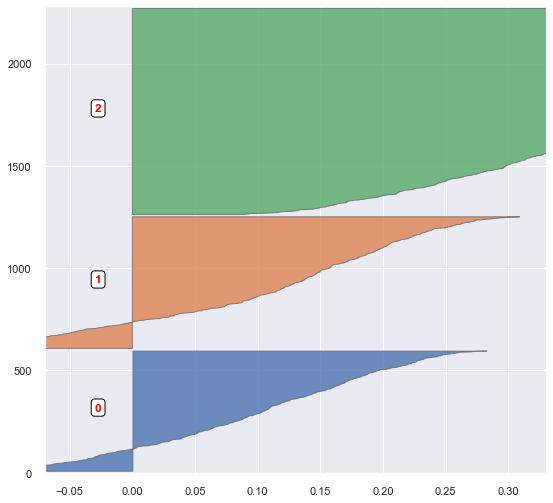

In [57]:
# Plotting the intra cluster silhouette distances.
from sklearn.metrics import silhouette_samples
sample_silhouette_values = silhouette_samples(scaled, clusters)
graph_component_silhouette(n_clusters, [-0.07, 0.33], len(X), sample_silhouette_values, clusters)

#### Dimensionality Analysis

   PCA

In [58]:
from sklearn.decomposition import PCA

In [59]:
pca = PCA()
pca.fit(scaled)
pca_samples = pca.transform(scaled)

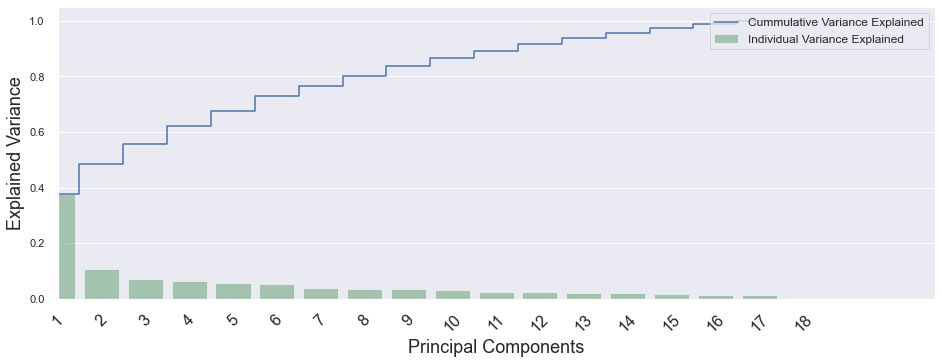

In [60]:
# Checking the amount of variance explained :
fig, ax = plt.subplots(figsize=(14, 5))
sns.set(font_scale=1)
plt.step(range(scaled.shape[1]), pca.explained_variance_ratio_.cumsum(), where = 'mid', label = 'Cummulative Variance Explained')
sns.barplot(np.arange(1, scaled.shape[1] + 1), pca.explained_variance_ratio_, alpha = 0.5, color = 'g',
            label = 'Individual Variance Explained')
plt.xlim(0, 20)
plt.xticks(rotation = 45, fontsize = 16)
ax.set_xticklabels([s  for s in ax.get_xticklabels()])

plt.ylabel("Explained Variance", fontsize = 18)
plt.xlabel("Principal Components", fontsize = 18)
plt.legend(loc = 'upper right', fontsize = 12)
plt.show()

In [61]:
data['fit_segmentacao']= kmeans.labels_

In [62]:
data

,ID,ano_nasc,educacao,estado_civil,renda_ano,crianca_casa,adoles_casa,dt_primcomp,recencia_dias,vinho_montante,frutas_montante,carne_montante,peixe_montante,doces_montante,ouro_montante,promocoes_desconto,promocoes_web,promocoes_catalogo,promocoes_store,num_visit_web_ult_mes,Cmp3,Cmp4,Cmp5,Cmp1,Cmp2,reclamacoes,target,age,renda_mes_media,campaing_engagement,digital_profile,fit_segmentacao
0,5524,1957,Graduation,Single,58138.0,0,0,09/2012,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,1,63,4844.833333,0.0,0,0
1,2174,1954,Graduation,Single,46344.0,1,1,03/2014,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,0,66,3862.000000,0.0,0,2
2,4141,1965,Graduation,Together,71613.0,0,0,08/2013,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,0,55,5967.750000,0.0,0,0
3,6182,1984,Graduation,Together,26646.0,1,0,02/2014,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,0,36,2220.500000,0.0,0,2
4,5324,1981,PhD,Married,58293.0,1,0,01/2014,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,0,39,4857.750000,0.0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,Graduation,Married,61223.0,0,1,06/2013,46,709,43,182,42,118,247,2,9,3,4,5,0,0,0,0,0,0,0,53,5101.916667,0.0,0,1
2236,4001,1946,PhD,Together,64014.0,2,1,06/2014,56,406,0,30,0,0,8,7,8,2,5,7,0,0,0,1,0,0,0,74,5334.500000,0.2,0,1
2237,7270,1981,Graduation,Divorced,56981.0,0,0,01/2014,91,908,48,217,32,12,24,1,2,3,13,6,0,1,0,0,0,0,0,39,4748.416667,0.2,0,0
2238,8235,1956,Master,Together,69245.0,0,1,01/2014,8,428,30,214,80,30,61,2,6,5,10,3,0,0,0,0,0,0,0,64,5770.416667,0.0,0,1


In [63]:
data['fit_segmentacao'] = data['fit_segmentacao'].astype(str)

#### Fit Segmentação Analysis

In [64]:
from pandas_profiling import ProfileReport
profile = ProfileReport(data, title="Data Profile Report")

In [65]:
profile

fit_segmentacao
0     588
1     644
2    1008
Name: fit_segmentacao, dtype: int64

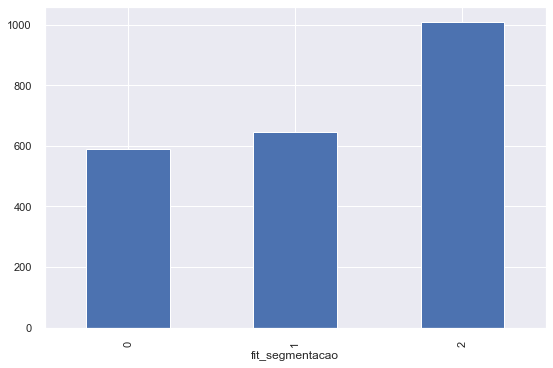

In [188]:
# Customer
data.groupby(['fit_segmentacao']).fit_segmentacao.count().sort_values().plot(kind='bar')
data.groupby(['fit_segmentacao']).fit_segmentacao.count().sort_values()

In [176]:
num_cluster = data[['renda_mes_media','age','crianca_casa','adoles_casa','recencia_dias','num_visit_web_ult_mes','campaing_engagement']]

<Figure size 576x396 with 0 Axes>

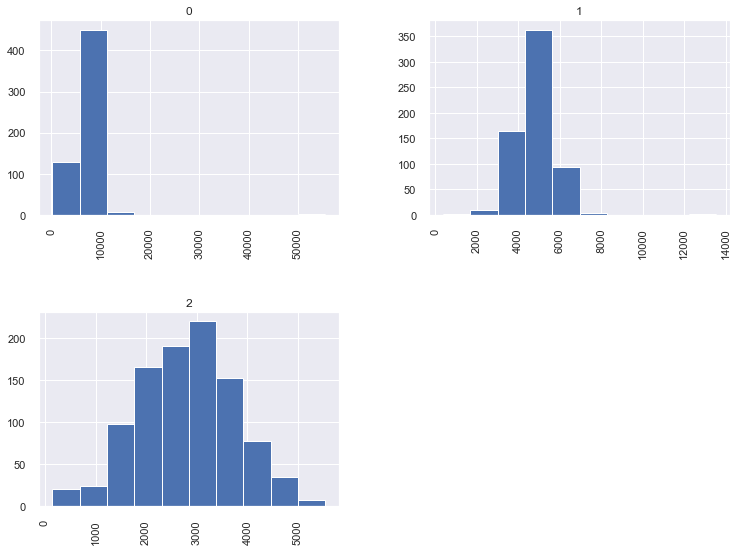

<Figure size 576x396 with 0 Axes>

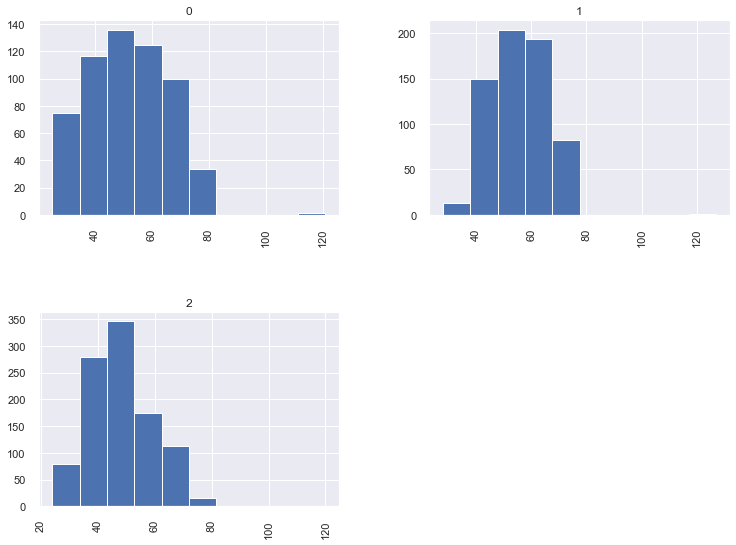

<Figure size 576x396 with 0 Axes>

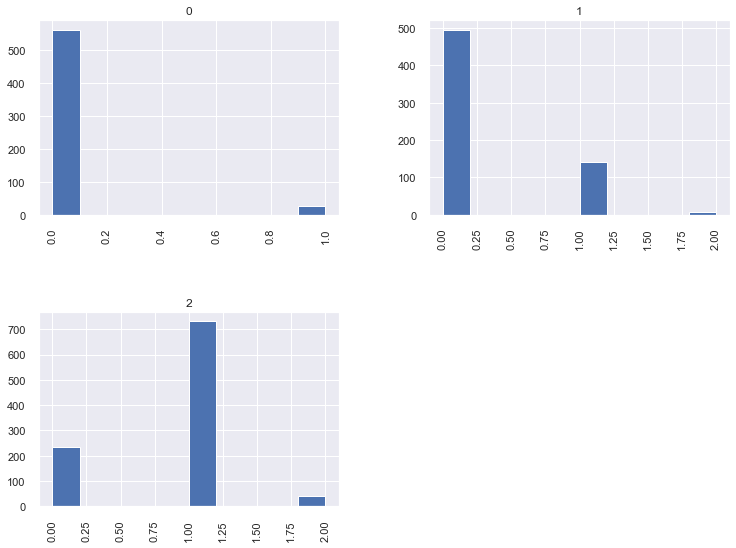

<Figure size 576x396 with 0 Axes>

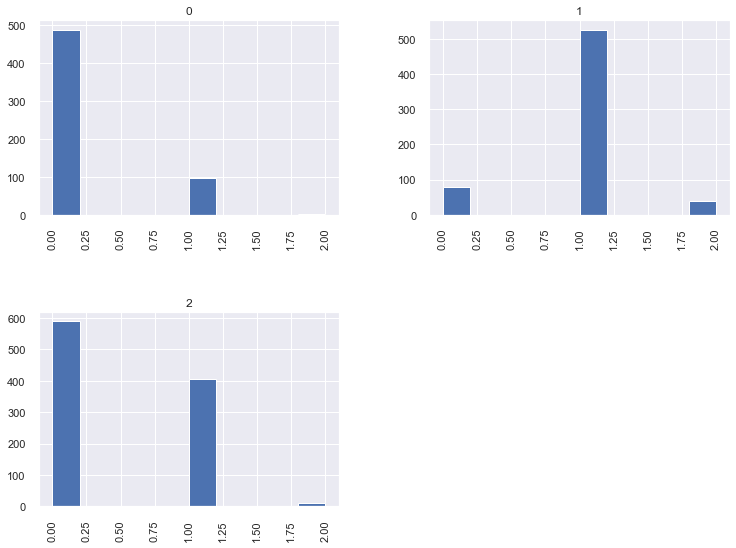

<Figure size 576x396 with 0 Axes>

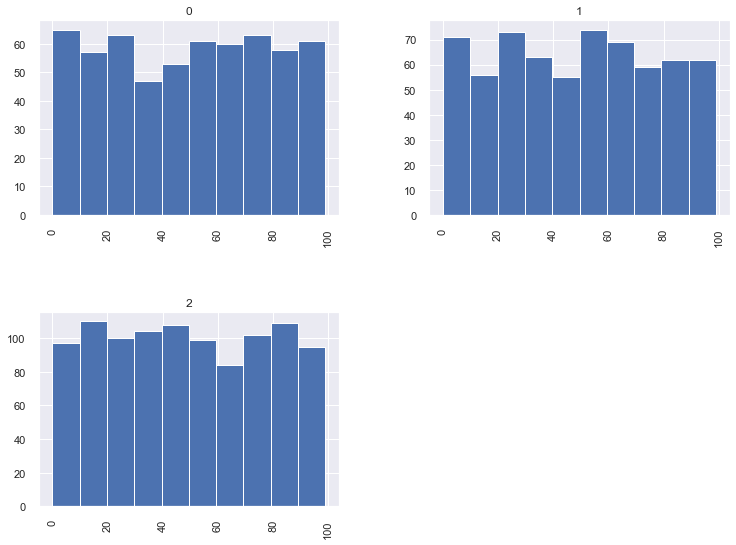

<Figure size 576x396 with 0 Axes>

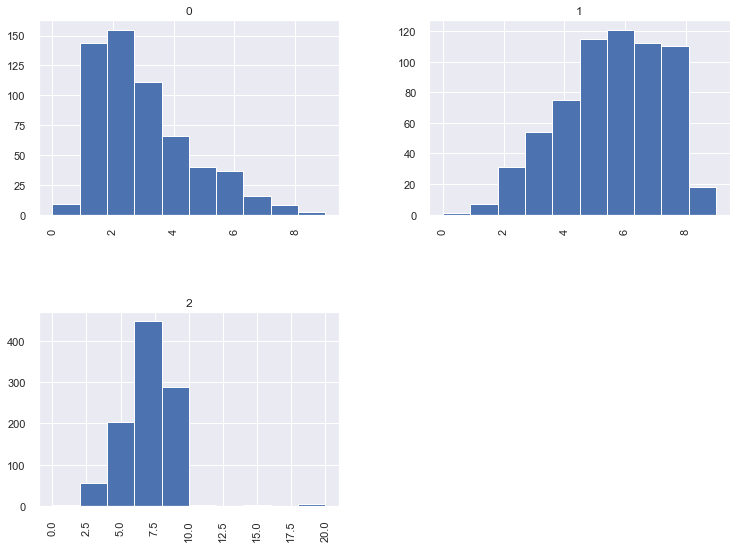

<Figure size 576x396 with 0 Axes>

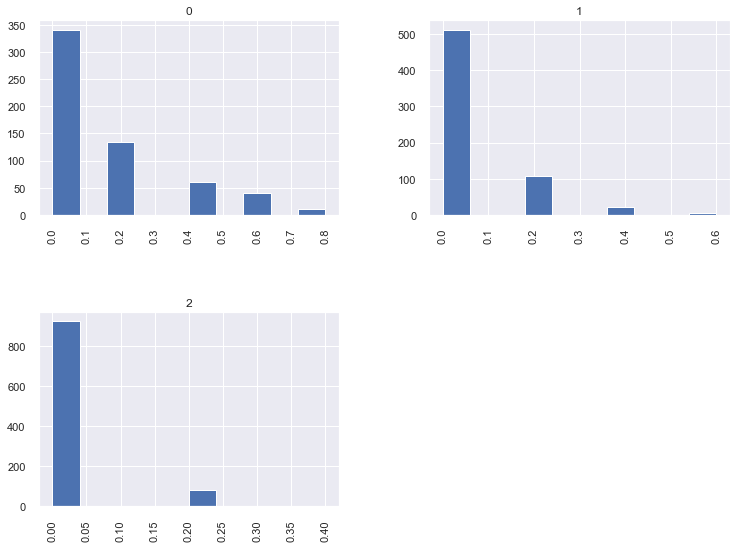

In [177]:
for att in num_cluster:
  figsize=(8,4)
  plt.figure()
  data[att].hist(by=data['fit_segmentacao'],figsize=(12,9))
  plt.title(att);

In [178]:
for att in num_cluster:
    print (att)
    
    print( data.groupby('fit_segmentacao', as_index=True)[att].describe())


renda_mes_media
                 count         mean          std         min          25%          50%        75%           max
fit_segmentacao                                                                                                
0                586.0  6465.720563  2308.773067  203.916667  5836.500000  6369.041667  6860.8750  55555.500000
1                638.0  4823.648119   946.464420  369.000000  4230.937500  4837.958333  5417.5625  13533.083333
2                992.0  2804.360887   964.706871  144.166667  2116.416667  2836.208333  3470.6250   5541.916667
age
                  count       mean        std   min   25%   50%   75%    max
fit_segmentacao                                                             
0                 588.0  51.661565  13.646152  25.0  41.0  51.0  63.0  121.0
1                 644.0  55.582298  10.127234  28.0  47.0  55.0  64.0  127.0
2                1008.0  48.118056  11.107355  24.0  40.0  47.0  55.0  120.0
crianca_casa
                  coun

fit_segmentacao
0     37
1     14
2    118
Name: digital_profile, dtype: int32

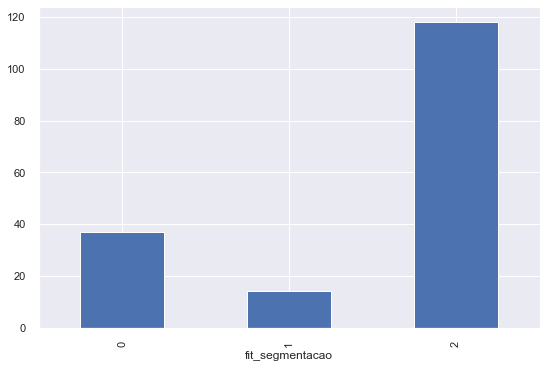

In [187]:
data['digital_profile'] = data['digital_profile'].astype(int)
data.groupby(['fit_segmentacao'])['digital_profile'].sum().plot.bar()
data.groupby(['fit_segmentacao'])['digital_profile'].sum()